In [1]:
library(Seurat)

library(dplyr)
library(glue)
library(ggplot2)
library(patchwork)
library(cowplot)
library(stringr)
library(tidyr)
library("dplyr")
library(velocyto.R)
library(SeuratWrappers)
library(stringr)
sample_id = c("mWT","mNFIXko")
myList = list()
s.genes <- str_to_title(cc.genes$s.genes)
g2m.genes <- str_to_title(cc.genes$g2m.genes)
for(i in 1:length(sample_id)){
    s=sample_id[i]
    dir = glue("{s}/outs/filtered_feature_bc_matrix")
    myData <- Read10X(data.dir = dir)
    myList[[i]]  <- CreateSeuratObject(counts = myData[["Gene Expression"]], min.cells = 0, min.features = 0,project = s, assay = "RNA")
    myList[[i]][["ADT"]] <- CreateAssayObject(myData[["Antibody Capture"]][, colnames(x = myList[[i]] )])

}
merged_obj = merge(myList[[1]], y = myList[[2]],add.cell.ids = sample_id)
merged_obj[["percent.mt"]] <- PercentageFeatureSet(merged_obj, pattern = "^mt-")
merged_obj <- subset(merged_obj, subset = nFeature_RNA >= 200 & nFeature_RNA <= 6000 & percent.mt <= 10 & nFeature_RNA <=50000)


Attaching SeuratObject


Attaching package: 'dplyr'


The following objects are masked from 'package:stats':

    filter, lag


The following objects are masked from 'package:base':

    intersect, setdiff, setequal, union



Attaching package: 'glue'


The following object is masked from 'package:dplyr':

    collapse



Attaching package: 'cowplot'


The following object is masked from 'package:patchwork':

    align_plots


Loading required package: Matrix


Attaching package: 'Matrix'


The following objects are masked from 'package:tidyr':

    expand, pack, unpack


10X data contains more than one type and is being returned as a list containing matrices of each type.

Warning message:
"Feature names cannot have underscores ('_'), replacing with dashes ('-')"
10X data contains more than one type and is being returned as a list containing matrices of each type.

Warning message:
"Feature names cannot have underscores ('_'), replacing with dashes ('-')"


In [2]:
merged_obj <- NormalizeData(merged_obj)
merged_obj <- FindVariableFeatures(merged_obj, selection.method = "vst")
merged_obj <- ScaleData(merged_obj, features = rownames(merged_obj))

Centering and scaling data matrix



In [3]:
merged_obj <- CellCycleScoring(merged_obj, s.features = s.genes, g2m.features = g2m.genes, set.ident = TRUE)


Warning message:
"The following features are not present in the object: Mlf1ip, not searching for symbol synonyms"
Warning message:
"The following features are not present in the object: Fam64a, Hn1, not searching for symbol synonyms"


Warning message in PrepDR(object = object, features = features, verbose = verbose):
"The following 3 features requested have not been scaled (running reduction without them): Mlf1ip, Fam64a, Hn1"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
PC_ 1 
Positive:  Mki67, Top2a, Birc5, Hmgb2, Cdca8, Cks2, Cks1b, Tpx2, Kif11, Ube2c 
	   Cdca3, Cenpf, Cdk1, Hmmr, Tubb4b, Nusap1, Rrm1, Smc4, Cenpa, Cenpe 
	   Aurkb, Gmnn, Kif20b, Clspn, Ckap2l, Tyms, Ncapd2, Cdc20, Ccnb2, Tmpo 
Negative:  Gas2l3, Ung, Msh2, Chaf1b, Cdca7, Ubr7, Casp8ap2, Ccne2, G2e3, Pold3 
	   Dscc1, Wdr76, Rfc2, Psrc1, Hells, Lbr, Gtse1, Ctcf, Exo1, Dtl 
	   Brip1, Cdc25c, Gins2, Mcm4, Cdc6, Rpa2, Cdc45, Mcm2, Blm, Mcm6 
PC_ 2 
Positive:  Ung, Uhrf1, Mcm6, Hells, Mcm4, Mcm2, Mcm5, Dtl, Tipin, Pcna 
	   Nasp, Atad2, Slbp, Gmnn, Cdca7, Rpa2, Gins2, Prim1, Rrm2, Clspn 
	   Cdc6, Rfc2, Wdr76, Dscc1, Ccne2, Casp8ap2, Rad5

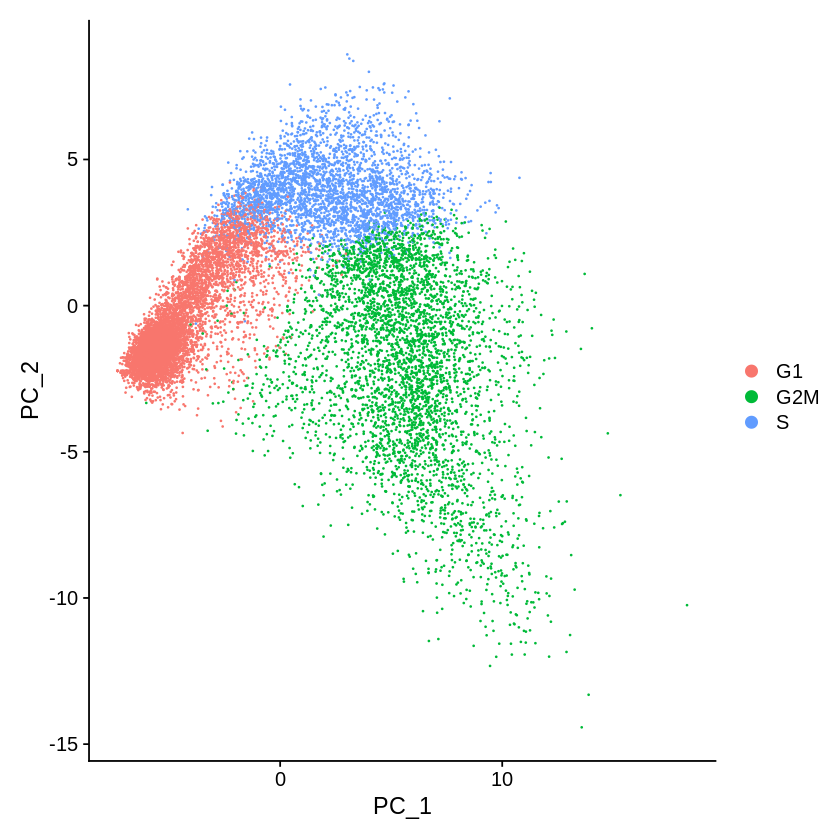

In [4]:
merged_obj <- RunPCA(merged_obj, features = c(s.genes, g2m.genes))
DimPlot(merged_obj,reduction="pca")

Picking joint bandwidth of 0.0551

Picking joint bandwidth of 0.0709

Picking joint bandwidth of 0.0894

Picking joint bandwidth of 0.0811



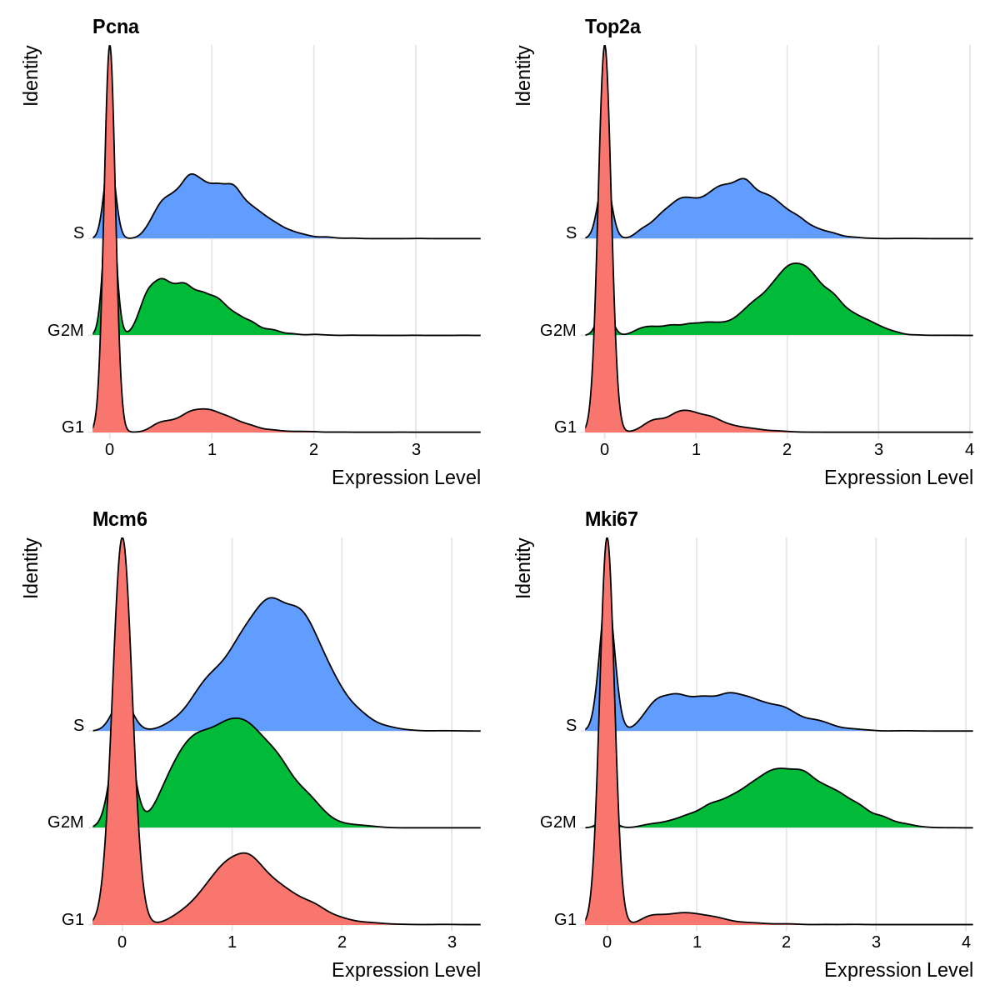

In [6]:
options(repr.plot.width = 10, repr.plot.height = 10,repr.plot.res=120)

RidgePlot(merged_obj, features = c("Pcna", "Top2a", "Mcm6", "Mki67"), ncol = 2)


In [8]:
# after
merged_obj$CC.Difference <- merged_obj$S.Score - merged_obj$G2M.Score
merged_obj <- ScaleData(merged_obj, vars.to.regress = "CC.Difference",verbose=T)

Regressing out CC.Difference

Centering and scaling data matrix



In [ ]:
merged_obj <- RunPCA(merged_obj, features = c(s.genes, g2m.genes))
DimPlot(merged_obj,reduction="pca")

Warning message in PrepDR(object = object, features = features, verbose = verbose):
"The following 26 features requested have not been scaled (running reduction without them): Gins2, Mcm6, Cdca7, Prim1, Mlf1ip, Rfc2, Rpa2, Wdr76, Ubr7, Pold3, Msh2, Cdc45, Exo1, Casp8ap2, Usp1, Chaf1b, Ndc80, Tmpo, Fam64a, Anp32e, Gtse1, Hn1, Ttk, Lbr, Ctcf, Cbx5"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
PC_ 1 
Positive:  Gas2l3, G2e3, Psrc1, Cdc25c, Ckap5, Ckap2, Kif23, Ect2, Nek2, Ung 
	   Cdca2, Brip1, Ccne2, Kif2c, Aurka, Dscc1, Hjurp, Blm, Dlgap5, Anln 
	   Rangap1, Cdc20, Ccnb2, Tacc3, Bub1, Nuf2, Ckap2l, Cdc6, E2f8, Pola1 
Negative:  Mki67, Top2a, Birc5, Hmgb2, Cdca8, Gmnn, Rrm1, Clspn, Nasp, Ube2c 
	   Cks1b, Cks2, Atad2, Tpx2, Rrm2, Uhrf1, Cenpf, Tyms, Kif11, Tipin 
	   Cdca3, Cdk1, Mcm5, Hmmr, Tubb4b, Fen1, Smc4, Rad51ap1, Slbp, Nusap1 
PC_ 2 
Positive:  Cenpa, Ccnb2, Cdc20, Cks2

In [79]:
merged_obj

An object of class Seurat 
31061 features across 13949 samples within 2 assays 
Active assay: RNA (31053 features, 0 variable features)
 1 other assay present: ADT

In [80]:
# before

Centering and scaling data matrix

Warning message in PrepDR(object = object, features = features, verbose = verbose):
"The following 3 features requested have not been scaled (running reduction without them): Mlf1ip, Fam64a, Hn1"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
PC_ 1 
Positive:  Mki67, Top2a, Birc5, Hmgb2, Cdca8, Cks2, Cks1b, Tpx2, Kif11, Ube2c 
	   Cdca3, Cenpf, Cdk1, Hmmr, Tubb4b, Nusap1, Rrm1, Smc4, Cenpa, Cenpe 
	   Aurkb, Gmnn, Kif20b, Clspn, Ckap2l, Tyms, Ncapd2, Cdc20, Ccnb2, Tmpo 
Negative:  Gas2l3, Ung, Msh2, Chaf1b, Cdca7, Ubr7, Casp8ap2, Ccne2, G2e3, Pold3 
	   Dscc1, Wdr76, Rfc2, Psrc1, Hells, Lbr, Gtse1, Ctcf, Exo1, Dtl 
	   Brip1, Cdc25c, Gins2, Mcm4, Cdc6, Rpa2, Cdc45, Mcm2, Blm, Mcm6 
PC_ 2 
Positive:  Ung, Uhrf1, Mcm6, Hells, Mcm4, Mcm2, Mcm5, Dtl, Tipin, Pcna 
	   Nasp, Atad2, Slbp, Gmnn, Cdca7, Rpa2, Gins2, Prim1, Rrm2, Clspn 
	   Cdc6, Rfc2, 

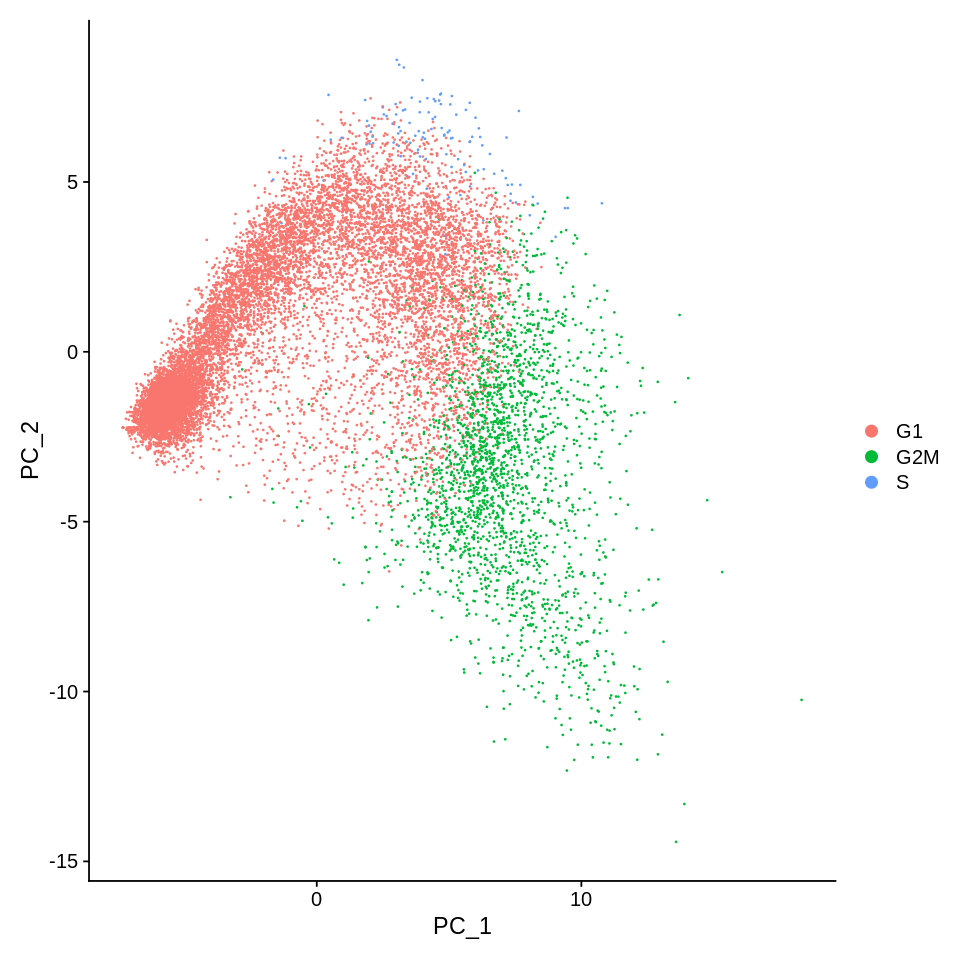

In [82]:
DefaultAssay(merged_obj) <- 'RNA'
merged_obj <- NormalizeData(merged_obj) %>% FindVariableFeatures() %>% ScaleData(features = rownames(merged_obj)) %>% RunPCA(features = c(s.genes, g2m.genes))
options(repr.plot.width = 8, repr.plot.height = 8)
DimPlot(merged_obj)

In [81]:
merged_obj <- RunPCA(merged_obj, features = c(s.genes, g2m.genes))
DimPlot(merged_obj,reduction="pca")

ERROR: Error in PrepDR(object = object, features = features, verbose = verbose): Data has not been scaled. Please run ScaleData and retry


In [ ]:
DefaultAssay(merged_obj) <- 'RNA'
merged_obj <- NormalizeData(merged_obj) %>% FindVariableFeatures() %>% ScaleData() %>% RunPCA()
options(repr.plot.width = 8, repr.plot.height = 8)
DimPlot(merged_obj)

In [4]:
cc.genes

$s.genes
 [1] "MCM5"     "PCNA"     "TYMS"     "FEN1"     "MCM2"     "MCM4"    
 [7] "RRM1"     "UNG"      "GINS2"    "MCM6"     "CDCA7"    "DTL"     
[13] "PRIM1"    "UHRF1"    "MLF1IP"   "HELLS"    "RFC2"     "RPA2"    
[19] "NASP"     "RAD51AP1" "GMNN"     "WDR76"    "SLBP"     "CCNE2"   
[25] "UBR7"     "POLD3"    "MSH2"     "ATAD2"    "RAD51"    "RRM2"    
[31] "CDC45"    "CDC6"     "EXO1"     "TIPIN"    "DSCC1"    "BLM"     
[37] "CASP8AP2" "USP1"     "CLSPN"    "POLA1"    "CHAF1B"   "BRIP1"   
[43] "E2F8"    

$g2m.genes
 [1] "HMGB2"   "CDK1"    "NUSAP1"  "UBE2C"   "BIRC5"   "TPX2"    "TOP2A"  
 [8] "NDC80"   "CKS2"    "NUF2"    "CKS1B"   "MKI67"   "TMPO"    "CENPF"  
[15] "TACC3"   "FAM64A"  "SMC4"    "CCNB2"   "CKAP2L"  "CKAP2"   "AURKB"  
[22] "BUB1"    "KIF11"   "ANP32E"  "TUBB4B"  "GTSE1"   "KIF20B"  "HJURP"  
[29] "CDCA3"   "HN1"     "CDC20"   "TTK"     "CDC25C"  "KIF2C"   "RANGAP1"
[36] "NCAPD2"  "DLGAP5"  "CDCA2"   "CDCA8"   "ECT2"    "KIF23"   "HMMR"   
[43] "AURKA"   "PSRC1"   "ANLN"    "LBR"     "CKAP5"   "CENPE"   "CTCF"   
[50] "NEK2"    "G2E3"    "GAS2L3"  "CBX5"    "CENPA"

Warning message in FetchData(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Mlf1ip”


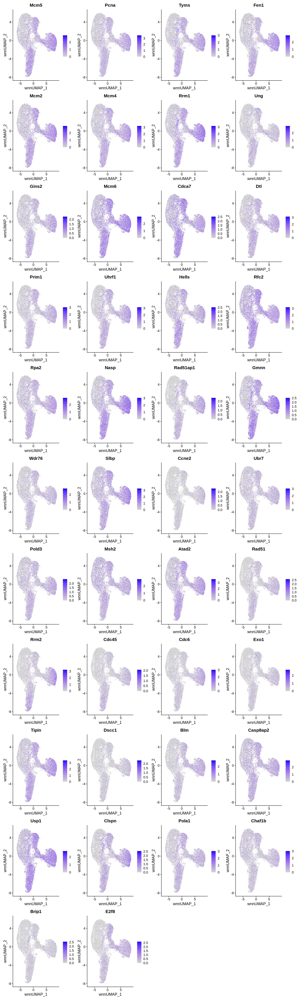

In [10]:
options(repr.plot.width = 15, repr.plot.height = 50)
FeaturePlot(merged_obj, features = str_to_title(s.genes), reduction = 'wnn.umap')


Warning message in FetchData(object = object, vars = c(dims, "ident", features), :
"The following requested variables were not found: Fam64a, Hn1"


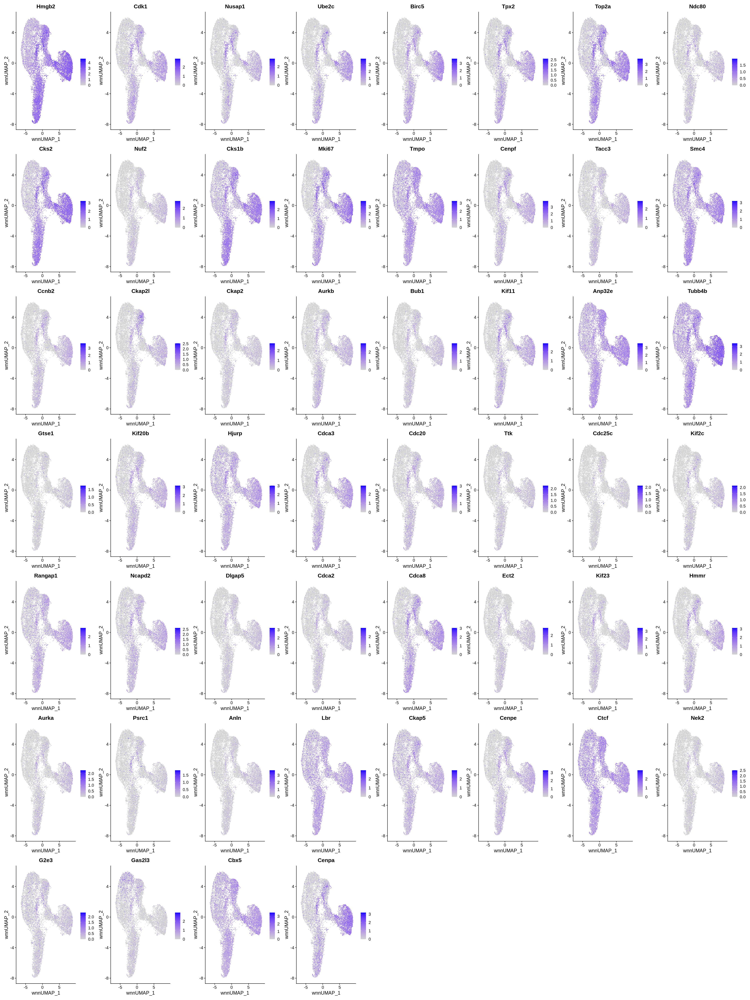

In [45]:
options(repr.plot.width = 30, repr.plot.height = 40,repr.plot.res=120)

FeaturePlot(merged_obj, features = str_to_title(g2m.genes), reduction = 'wnn.umap',ncol =8)


Warning message in FetchData(object = object, vars = c(dims, "ident", features), :
"The following requested variables were not found: Mlf1ip"


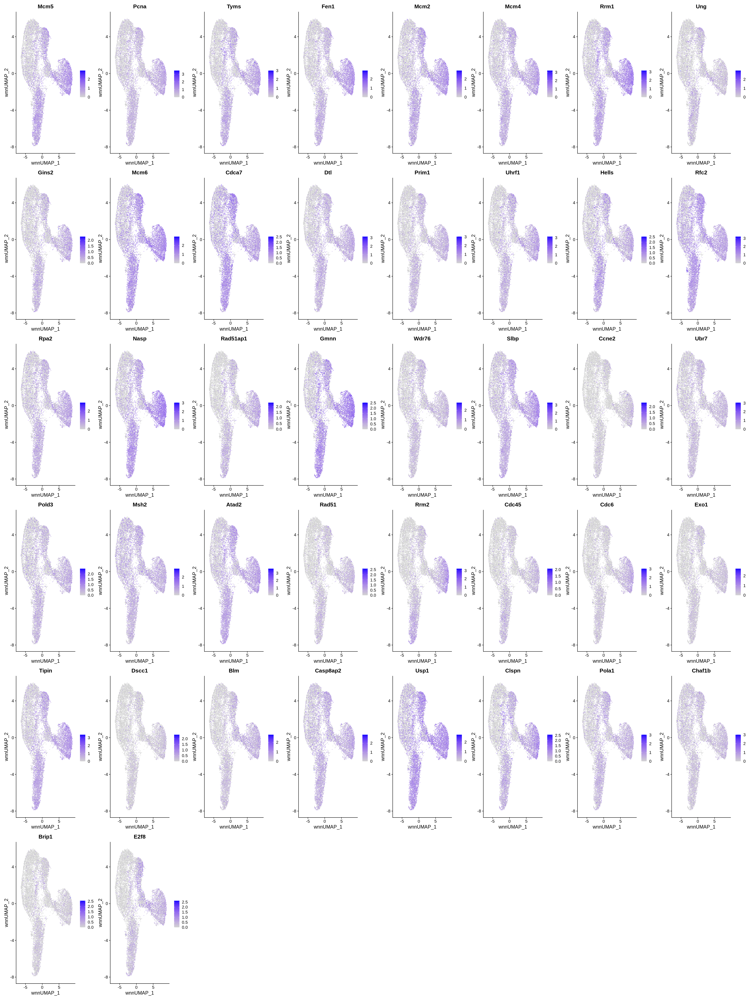

In [46]:
options(repr.plot.width = 30, repr.plot.height = 40,repr.plot.res=120)

FeaturePlot(merged_obj, features = str_to_title(s.genes), reduction = 'wnn.umap',ncol =8)


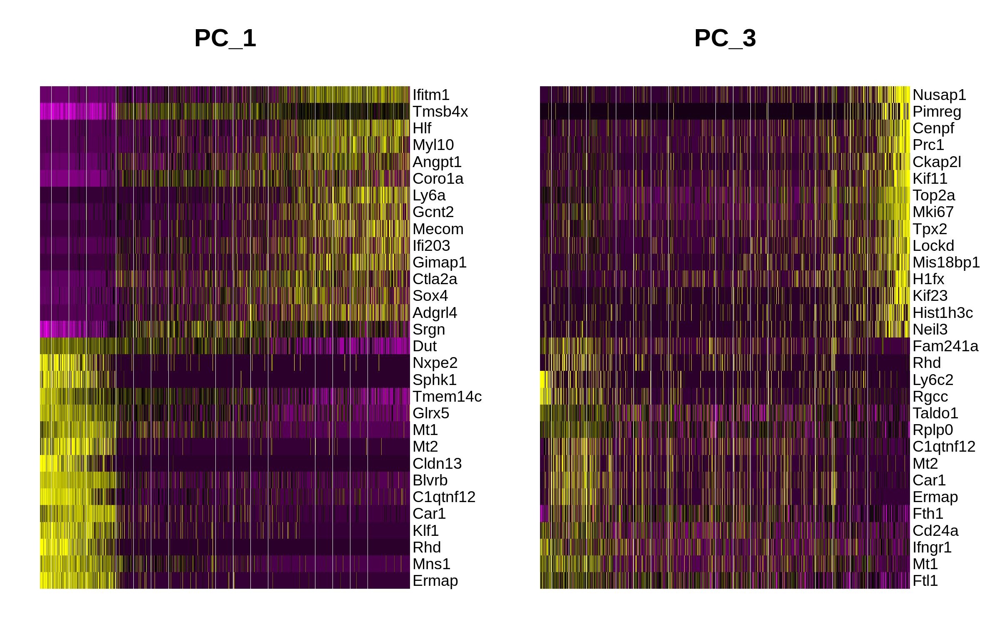

In [27]:
options(repr.plot.width = 8, repr.plot.height = 5,repr.plot.res=300)
DimHeatmap(merged_obj,dims = c(1,3))

In [60]:
merged_obj <- CellCycleScoring(merged_obj, s.features = s.genes, g2m.features = g2m.genes, set.ident = TRUE)


Warning message:
"The following features are not present in the object: Mlf1ip, not searching for symbol synonyms"
Warning message:
"The following features are not present in the object: Fam64a, Hn1, not searching for symbol synonyms"


In [61]:
head(merged_obj[[]])

,orig.ident,nCount_RNA,nFeature_RNA,nCount_ADT,nFeature_ADT,percent.mt,RNA.weight,ADT.weight,wsnn_res.1,seurat_clusters,Blood_pred,BM_pred,Bone_pred,id,S.Score,G2M.Score,Phase,old.ident
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,<fct>,<fct>,<fct>,<fct>,<fct>,<chr>,<dbl>,<dbl>,<chr>,<fct>
mWT_AAACCCAAGTGATCGG-1,mWT,3787,1690,103,7,5.307631,0.129729865,0.8702701,9,9,9,9,9,reference,-0.264718335,-0.23655684,G1,G1
mWT_AAACCCACAAACCATC-1,mWT,13420,3991,284,8,3.204173,0.040801805,0.9591982,3,3,3,Hematopoietic Stem Cell,3,reference,-0.292356896,-0.24428204,G1,G1
mWT_AAACCCACACTGTCCT-1,mWT,20299,4446,208,7,1.059165,0.135924221,0.8640758,0,0,0,"Red Blood Cell (Erythrocyte), Stem Cell",Progenitor Cell,reference,-0.091990828,0.17973530,G2M,G2M
mWT_AAACCCACAGCCATTA-1,mWT,11463,3649,180,8,2.852656,0.118308303,0.8816917,9,9,9,9,9,reference,-0.001030188,0.01822655,G2M,G2M
mWT_AAACCCAGTACCTAAC-1,mWT,22463,5146,414,8,3.770645,0.001217896,0.9987821,5,5,5,Megakaryocyte,5,reference,-0.304517525,0.42806296,G2M,G2M
mWT_AAACCCAGTCCTCCTA-1,mWT,28107,5085,196,8,1.946134,0.093460246,0.9065398,6,6,6,Stage I Neutrophil,6,reference,-0.239271139,0.35613581,G2M,G2M


Picking joint bandwidth of 0.0551

Picking joint bandwidth of 0.0709

Picking joint bandwidth of 0.0894

Picking joint bandwidth of 0.0811



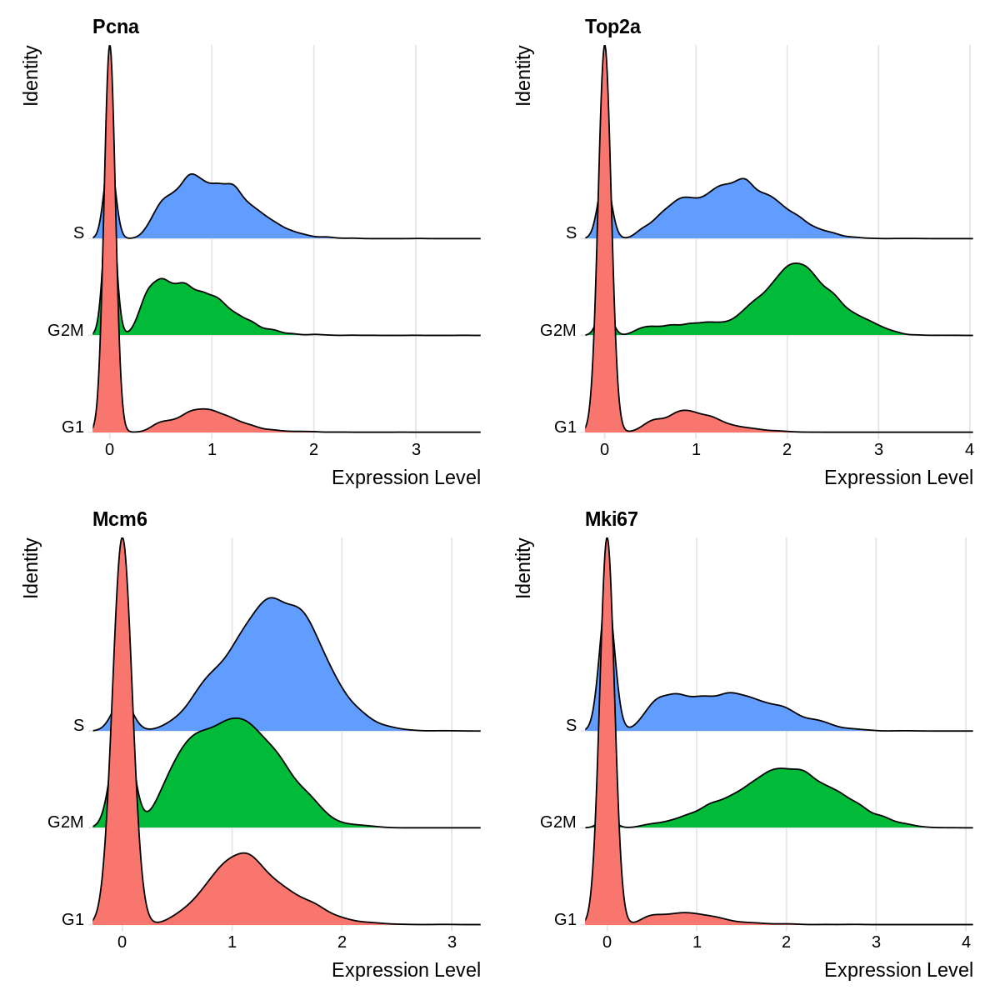

In [51]:
options(repr.plot.width = 10, repr.plot.height = 10,repr.plot.res=120)

RidgePlot(merged_obj, features = c("Pcna", "Top2a", "Mcm6", "Mki67"), ncol = 2)


Picking joint bandwidth of 0.0814

Picking joint bandwidth of 0.117

Picking joint bandwidth of 0.124

Picking joint bandwidth of 0.11



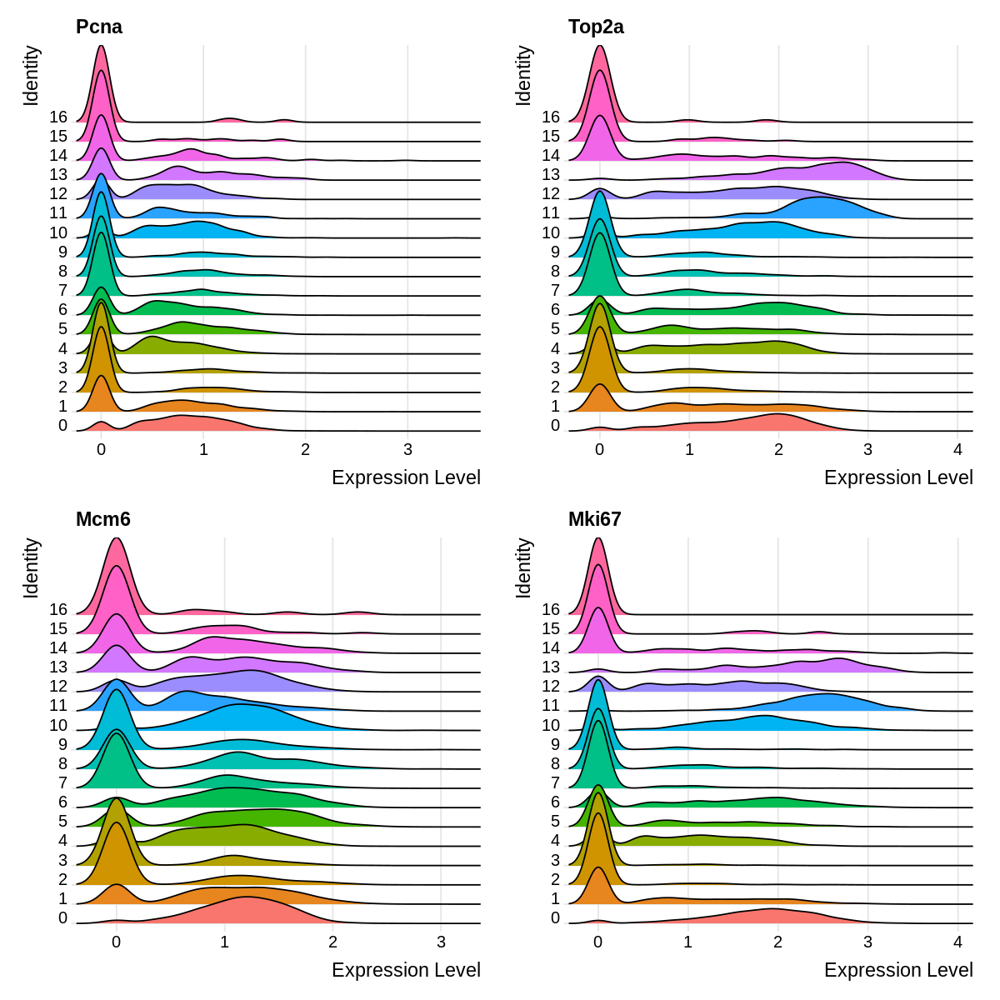

In [56]:
options(repr.plot.width = 10, repr.plot.height = 10,repr.plot.res=120)

RidgePlot(merged_obj, features = c("Pcna", "Top2a", "Mcm6", "Mki67"), ncol = 2,group.by="seurat_clusters")


Warning message in PrepDR(object = object, features = features, verbose = verbose):
"The following 26 features requested have not been scaled (running reduction without them): Gins2, Mcm6, Cdca7, Prim1, Mlf1ip, Rfc2, Rpa2, Wdr76, Ubr7, Pold3, Msh2, Cdc45, Exo1, Casp8ap2, Usp1, Chaf1b, Ndc80, Tmpo, Fam64a, Anp32e, Gtse1, Hn1, Ttk, Lbr, Ctcf, Cbx5"
Warning message in irlba(A = t(x = object), nv = npcs, ...):
"You're computing too large a percentage of total singular values, use a standard svd instead."
PC_ 1 
Positive:  Ung, Gas2l3, Ccne2, Dscc1, Hells, Dtl, G2e3, Mcm4, Brip1, Psrc1 
	   Cdc6, Mcm2, Cdc25c, Pcna, Blm, Pola1, Uhrf1, Rad51, Slbp, Ckap2 
	   Mcm5, E2f8, Ect2, Ckap5, Nek2, Tipin, Hjurp, Cdca2, Atad2, Kif23 
Negative:  Mki67, Top2a, Birc5, Hmgb2, Cdca8, Ube2c, Tpx2, Cks2, Cenpf, Kif11 
	   Cdca3, Hmmr, Cks1b, Cdk1, Nusap1, Tubb4b, Cenpa, Cenpe, Smc4, Aurkb 
	   Rrm1, Kif20b, Cdc20, Ccnb2, Ckap2l, Ncapd2, Bub1, Gmnn, Nuf2, Clspn 
PC_ 2 
Positive:  Ube2c, Cenpf, Hmmr, Kif23, Nu

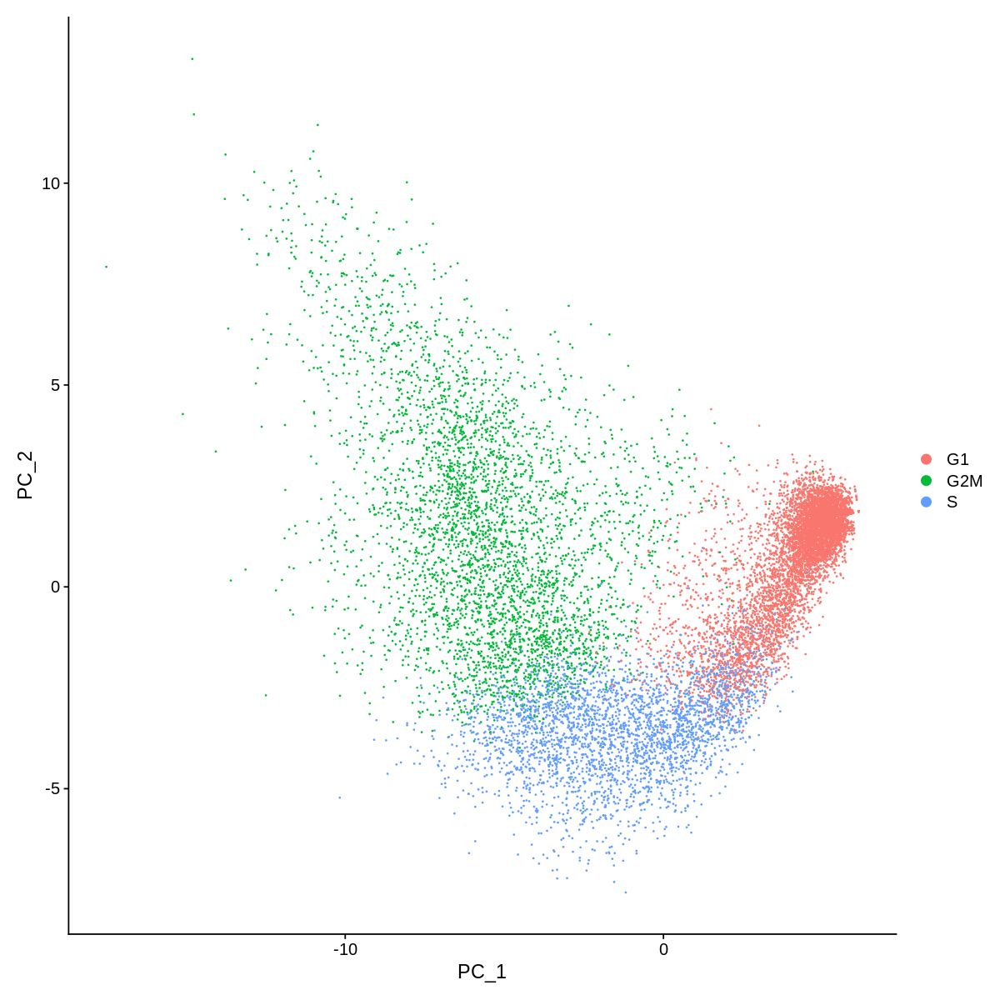

In [65]:
merged_obj <- RunPCA(merged_obj, features = c(s.genes, g2m.genes))
DimPlot(merged_obj,reduction="pca")

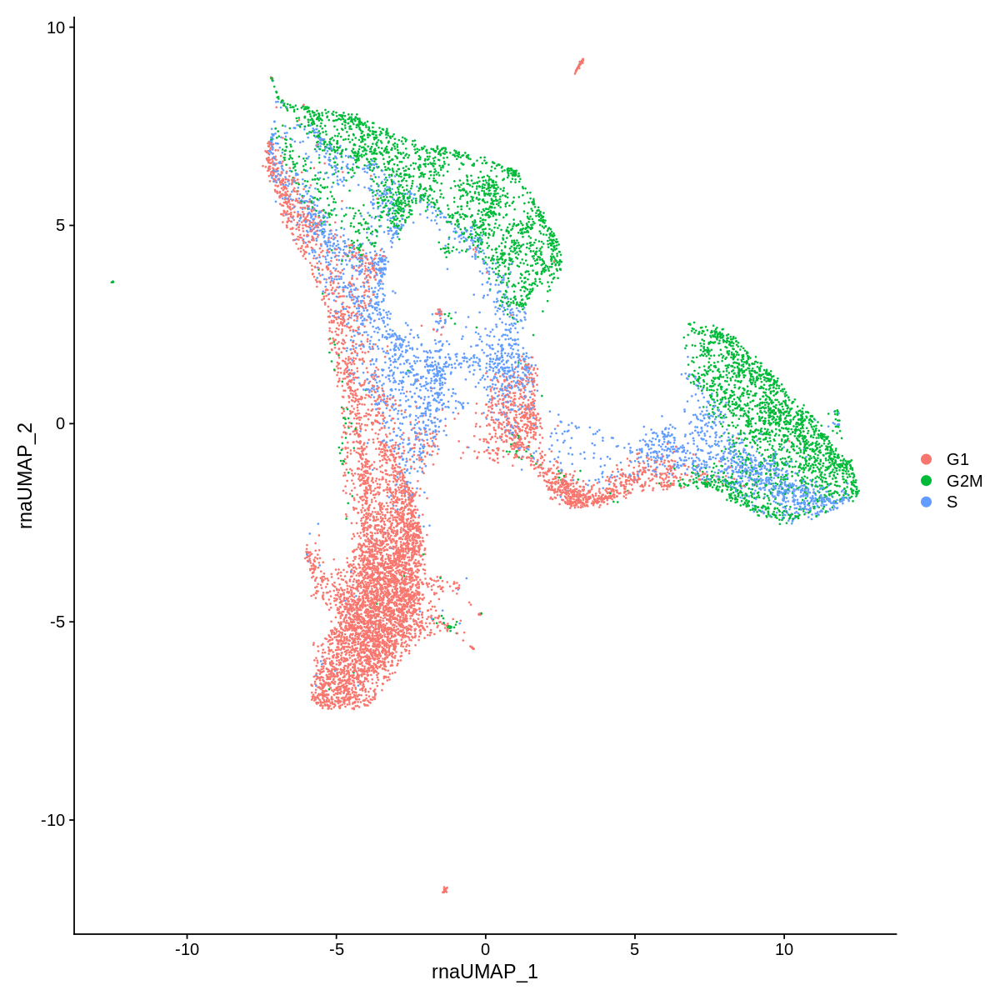

In [66]:
DimPlot(merged_obj)

In [68]:
start.time <- Sys.time()
merged_obj$CC.Difference <- merged_obj$S.Score - merged_obj$G2M.Score
merged_obj <- ScaleData(merged_obj, vars.to.regress = "CC.Difference", features = rownames(merged_obj),verbose=T,block.size=10000)
end.time <- Sys.time()
time.taken <- end.time - start.time
time.taken

Regressing out CC.Difference



In [69]:
?ScaleData

ScaleData {Seurat},R Documentation
object,An object
...,Arguments passed to other methods
features,Vector of features names to scale/center. Default is variable features.
vars.to.regress,"Variables to regress out (previously latent.vars in RegressOut). For example, nUMI, or percent.mito."
latent.data,"Extra data to regress out, should be cells x latent data"
split.by,Name of variable in object metadata or a vector or factor defining grouping of cells. See argument f in split for more details
model.use,"Use a linear model or generalized linear model (poisson, negative binomial) for the regression. Options are 'linear' (default), 'poisson', and 'negbinom'"
use.umi,"Regress on UMI count data. Default is FALSE for linear modeling, but automatically set to TRUE if model.use is 'negbinom' or 'poisson'"
do.scale,Whether to scale the data.
do.center,Whether to center the data.


In [84]:
s.genes <- str_to_title(cc.genes$s.genes)
g2m.genes <- str_to_title(cc.genes$g2m.genes)

In [85]:
merged_obj <- CellCycleScoring(merged_obj, s.features = s.genes, g2m.features = g2m.genes, set.ident = TRUE)


Warning message:
"The following features are not present in the object: Mlf1ip, not searching for symbol synonyms"
Warning message:
"The following features are not present in the object: Fam64a, Hn1, not searching for symbol synonyms"


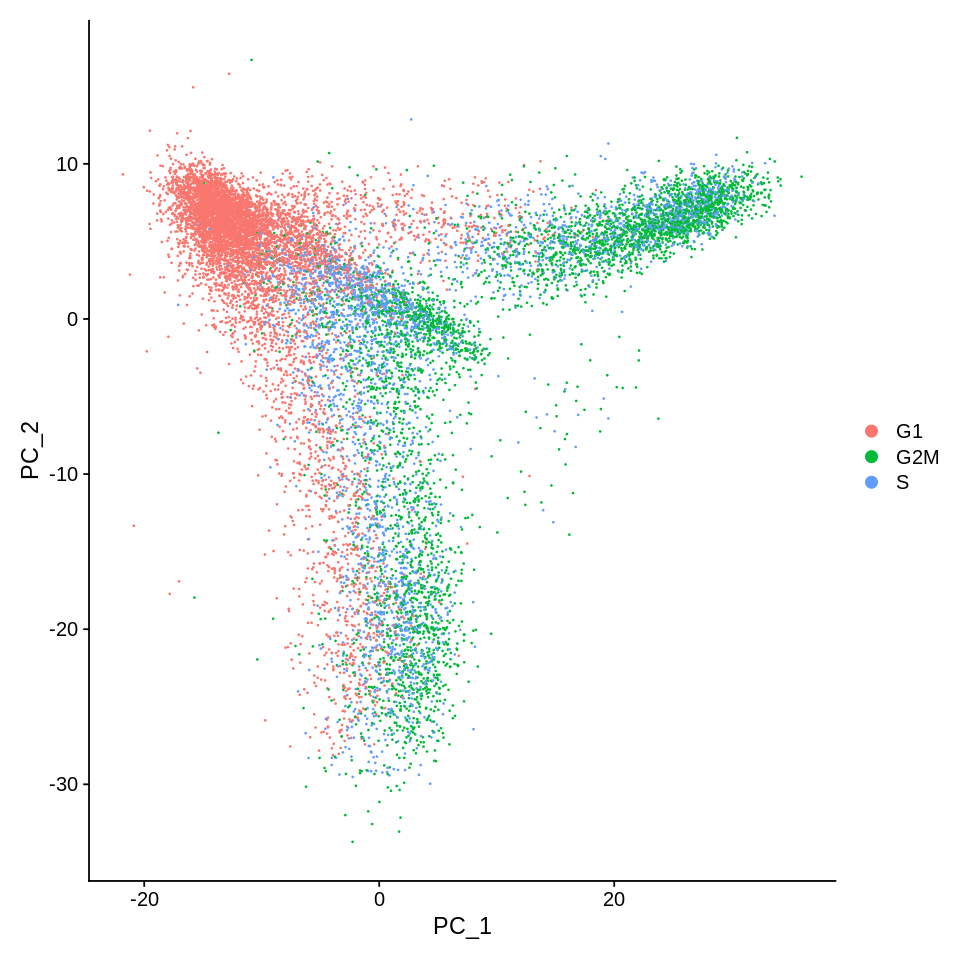

In [86]:
DimPlot(merged_obj,reduction="pca")

In [88]:
merged_obj@assays$RNA@data[merged_obj@assays$RNA@var.features,]

   [[ suppressing 32 column names 'mWT_AAACCCAAGTGATCGG-1', 'mWT_AAACCCACAAACCATC-1', 'mWT_AAACCCACACTGTCCT-1' ... ]]



2000 x 13949 sparse Matrix of class "dgCMatrix"
                                                                         
S100a8         .        .         .         .         0.3682315 .        
S100a9         .        .         .         .         0.6367636 .        
Pf4            .        .         .         0.6272061 .         .        
Camp           .        .         .         .         .         .        
Ngp            .        .         .         .         .         .        
Chil3          .        0.5568442 .         .         .         .        
Hbb-bs         .        .         .         .         .         .        
Lcn2           .        .         .         .         .         .        
Ccl5           .        .         .         0.6272061 .         0.3043793
Cma1           .        .         .         .         .         .        
Hba-a1         .        .         .         .         .         .        
Elane          .        0.5568442 0.6857550 1.0096878 0.6367636 

In [83]:
library(Seurat)

library(dplyr)
library(glue)
library(ggplot2)
library(patchwork)
library(cowplot)
library(stringr)
library(tidyr)
library("dplyr")
library(velocyto.R)
library(stringr)
library(SeuratWrappers)
load("6_18.RData")